# (22) DOVES — 16x16

**Motivation**: Xtract $16 \times 16$ tiles, save as npy. <br>

In [1]:
# HIDE CODE


import os, sys
from IPython.display import display

# tmp & extras dir
git_dir = os.path.join(os.environ['HOME'], 'Dropbox/git')
extras_dir = os.path.join(git_dir, 'jb-vae/_extras')
fig_base_dir = os.path.join(git_dir, 'jb-vae/figs')
tmp_dir = os.path.join(git_dir, 'jb-vae/tmp')

# GitHub
sys.path.insert(0, os.path.join(git_dir, '_PoissonVAE'))
from figures.fighelper import *

# warnings, tqdm, & style
warnings.filterwarnings('ignore', category=DeprecationWarning)
from rich.jupyter import print
%matplotlib inline
set_style()

In [2]:
import torchvision
from torch.nn import functional as F
from torchvision.transforms import v2
from torch.utils.data import DataLoader

from _tmp.imgproc import (
    do_process, xtract_patches,
    do_fft, compute_fftfreq,
)
from _tmp.doves import EyeDataset

## DOVES $(24 \rightarrow 16)$

In [3]:
npix = 24
doves = EyeDataset(grid_w=npix, grid_h=npix)

In [4]:
x = doves.build(ids_img=range(20, 30), ids_traj=0)
x_wt, x_wt_cn, x_wt_cn_zs = do_process(x)
x = x[..., 4:-4, 4:-4]
x.shape

torch.Size([10, 1024, 1, 16, 16])

In [7]:
ncols = 10

ids = {
    i: np.random.choice(range(len(x[i])))
    for i in range(ncols)
}

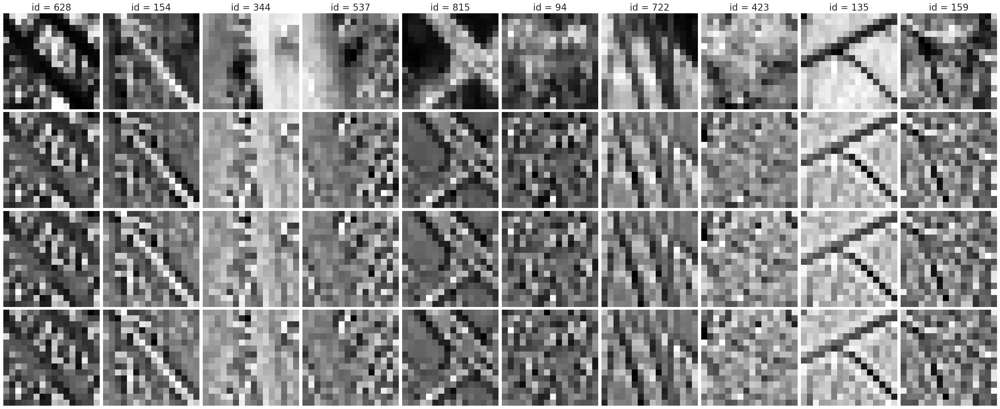

In [8]:
fig, axes = create_figure(4, ncols, (3.0 * ncols, 12.2), 'all', 'all', layout='constrained')
for i in range(10):
    axes[0, i].imshow(to_np(x[i, ids[i]].squeeze()), cmap='Greys_r')
    axes[1, i].imshow(to_np(x_wt[i, ids[i]].squeeze()), cmap='Greys_r')
    axes[2, i].imshow(to_np(x_wt_cn[i, ids[i]].squeeze()), cmap='Greys_r')
    axes[3, i].imshow(to_np(x_wt_cn_zs[i, ids[i]].squeeze()), cmap='Greys_r')
    axes[0, i].set_title(f"id = {ids[i]}", fontsize=20)
remove_ticks(axes)
plt.show()

In [9]:
ncols = 10

ids = {
    i: np.random.choice(range(len(x[i])))
    for i in range(ncols)
}

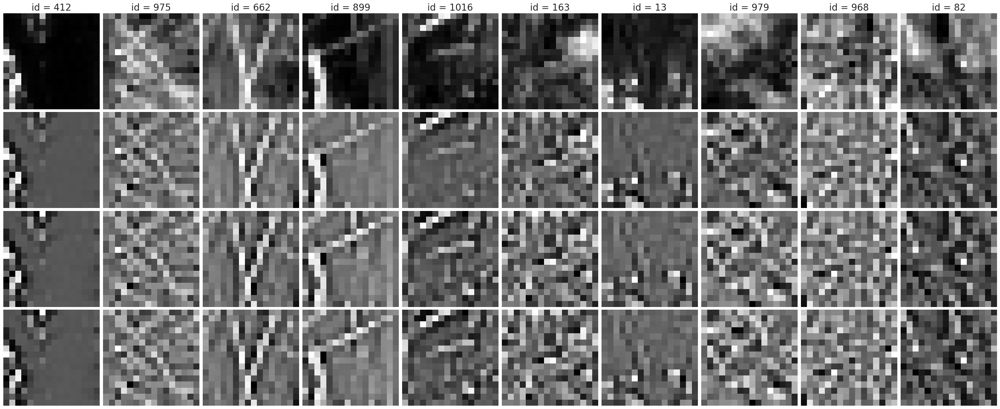

In [10]:
fig, axes = create_figure(4, ncols, (3.0 * ncols, 12.2), 'all', 'all', layout='constrained')
for i in range(10):
    axes[0, i].imshow(to_np(x[i, ids[i]].squeeze()), cmap='Greys_r')
    axes[1, i].imshow(to_np(x_wt[i, ids[i]].squeeze()), cmap='Greys_r')
    axes[2, i].imshow(to_np(x_wt_cn[i, ids[i]].squeeze()), cmap='Greys_r')
    axes[3, i].imshow(to_np(x_wt_cn_zs[i, ids[i]].squeeze()), cmap='Greys_r')
    axes[0, i].set_title(f"id = {ids[i]}", fontsize=20)
remove_ticks(axes)
plt.show()

In [6]:
len(doves.imgs), len(doves.trajs)

(101, 814)

In [7]:
x = doves.build(ids_img=range(len(doves.imgs)), ids_traj=range(3), verbose=True)
x_wt, x_wt_cn, x_wt_cn_zs = do_process(x)
x = x[..., 4:-4, 4:-4]

100%|█████████████████████████████████████████| 303/303 [00:39<00:00,  7.76it/s]


In [8]:
%%time

psd = []
for _x in x_wt_cn_zs:
    psd.append(do_fft(_x))

psd = np.concatenate(psd)
psd.shape

CPU times: user 26.9 s, sys: 16 ms, total: 26.9 s
Wall time: 26.9 s


(310272, 16)

In [9]:
good = np.isnan(psd).sum(1) == 0
len(psd) - good.sum()

0

In [10]:
kvals = compute_fftfreq(x_wt_cn_zs.shape[-1])[1]
lin_reg = sp_stats.linregress(x=np.log(kvals), y=np.log(psd[good].mean(0)))
log_line = np.log(kvals) * lin_reg.slope + lin_reg.intercept

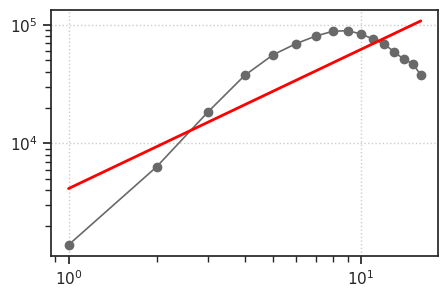

In [11]:
plt.loglog(kvals, psd[good].mean(0), marker='o', lw=1.2, color='dimgrey')
plt.loglog(kvals, np.exp(log_line), color='r', lw=2, ls='-')
plt.grid()
plt.show()

In [12]:
lin_reg

LinregressResult(slope=1.174311300203622, intercept=8.33044069391874, rvalue=0.8251211531595473, pvalue=8.333277650407283e-05, stderr=0.21488989363729855, intercept_stderr=0.4434603221606965)

In [3]:
doves = EyeDataset()
doves.imgs.shape

torch.Size([101, 1, 768, 1024])

In [4]:
x_wt, x_wt_cn, x_wt_cn_zs = do_process(doves.imgs)
x = doves.imgs[..., 4:-4, 4:-4]
x.shape

torch.Size([101, 1, 760, 1016])

In [12]:
ncols = 10

ids = np.random.choice(range(len(x)), ncols)

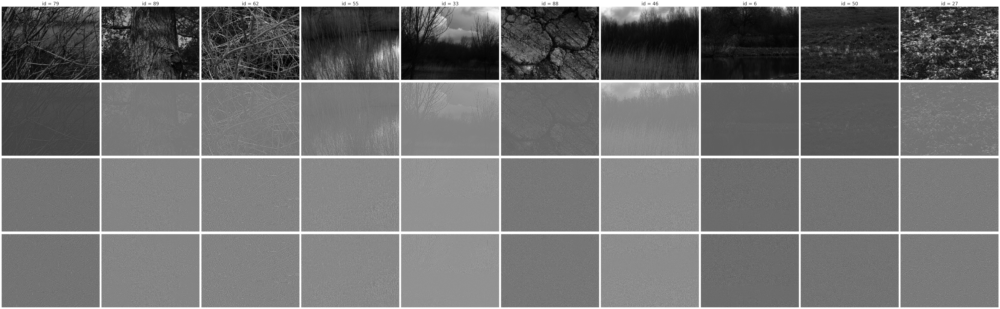

In [19]:
fig, axes = create_figure(4, ncols, (6.0 * ncols, 18.5), 'all', 'all', layout='constrained')
for i in range(10):
    axes[0, i].imshow(to_np(x[ids[i]].squeeze()), cmap='Greys_r')
    axes[1, i].imshow(to_np(x_wt[ids[i]].squeeze()), cmap='Greys_r')
    axes[2, i].imshow(to_np(x_wt_cn[ids[i]].squeeze()), cmap='Greys_r')
    axes[3, i].imshow(to_np(x_wt_cn_zs[ids[i]].squeeze()), cmap='Greys_r')
    axes[0, i].set_title(f"id = {ids[i]}", fontsize=20)
remove_ticks(axes)
plt.show()

In [35]:
npix = 40
dims = (npix, npix)

patches = doves.imgs.unfold(2, *dims).unfold(3, *dims)
# patches = patches.contiguous().view(*doves.imgs.shape[:2], -1, *s)
patches.shape

torch.Size([101, 1, 19, 25, 40, 40])

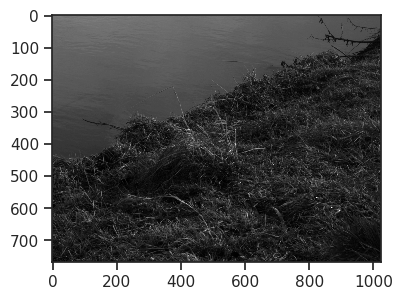

In [36]:
x2p = to_np(doves.imgs[66].squeeze())
kws = dict(
    vmin=np.min(x2p),
    vmax=np.max(x2p),
    cmap='Greys_r',
)
plt.imshow(x2p, **kws);

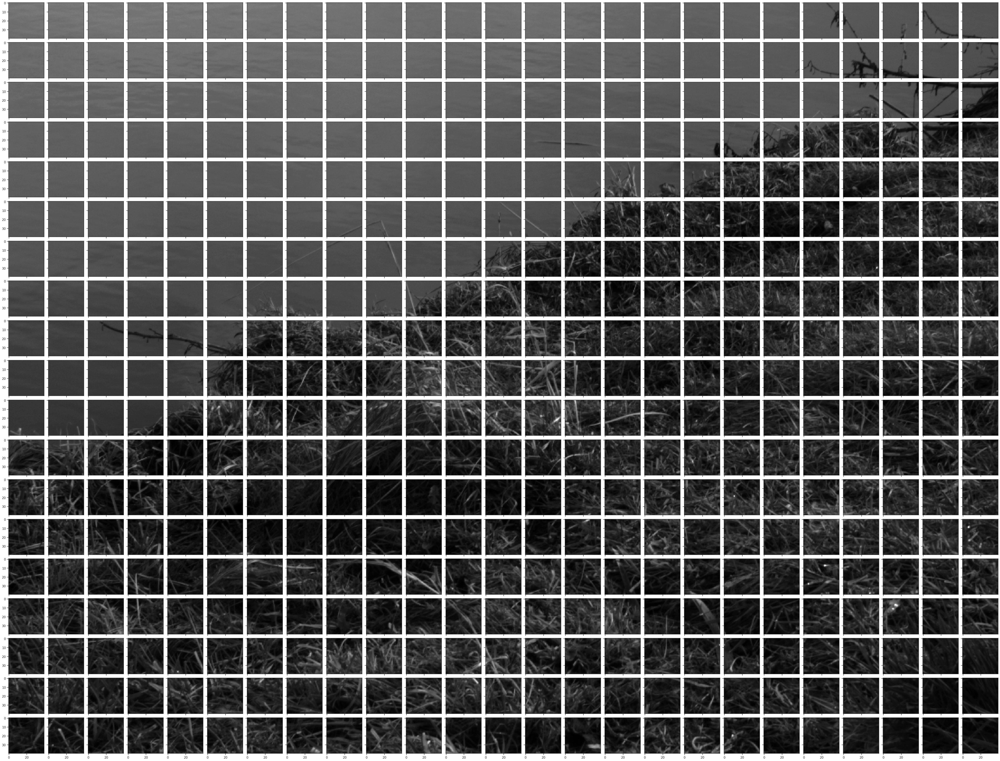

In [37]:
fig, axes = create_figure(19, 25, (25 * 2, 19 * 2), 'all', 'all', layout='constrained')
for i in range(19):
    for j in range(25):
        ax = axes[i, j]
        ax.imshow(to_np(patches[66, 0, i, j]), **kws)
plt.show()

### Verify if ```xtract_patches()``` works

In [6]:
doves = EyeDataset()
patches = xtract_patches(doves.imgs, 40)

doves.imgs.shape, patches.shape

(torch.Size([101, 1, 768, 1024]), torch.Size([101, 475, 1, 40, 40]))

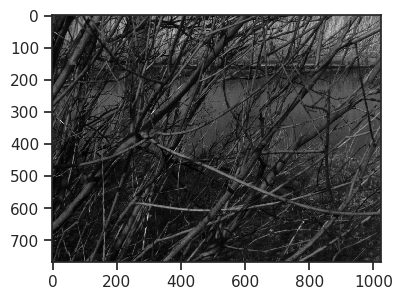

In [14]:
img_i = 79
x2p = to_np(doves.imgs[img_i].squeeze())
kws = dict(
    vmin=np.min(x2p),
    vmax=np.max(x2p),
    cmap='Greys_r',
)
plt.imshow(x2p, **kws);

In [19]:
nrows, ncols = [e//40 for e in doves.imgs.shape[-2:]]
nrows, ncols

(19, 25)

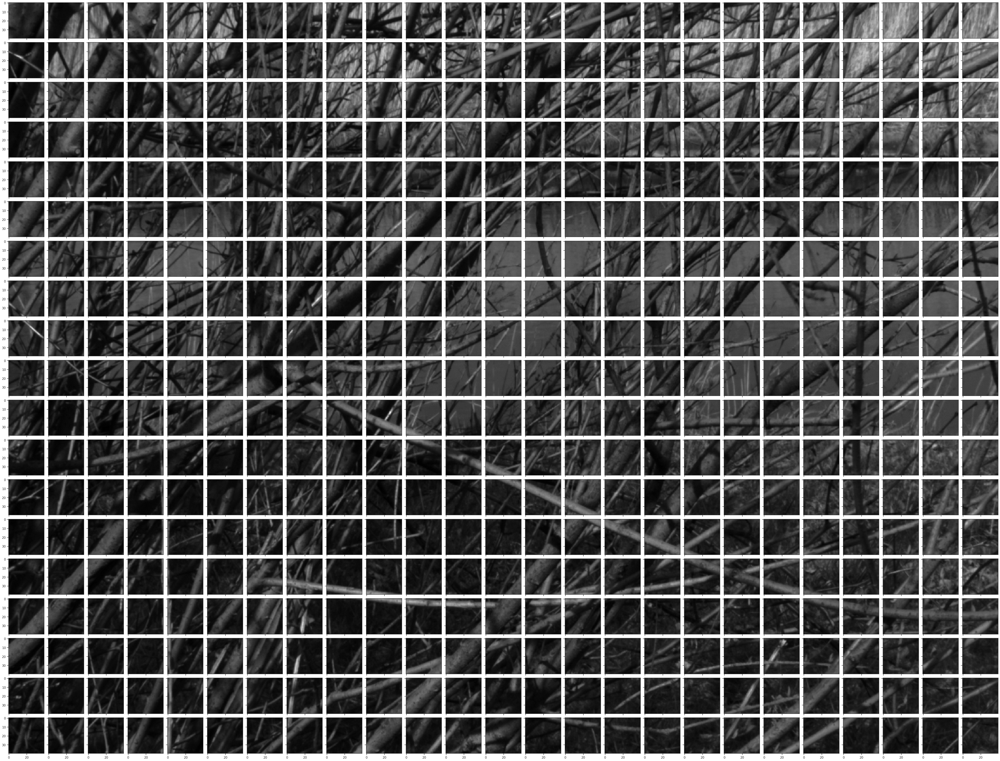

CPU times: user 3min 47s, sys: 194 ms, total: 3min 47s
Wall time: 3min 47s


In [27]:
%%time

fig, axes = create_figure(nrows, ncols, (ncols * 2, nrows * 2), 'all', 'all', layout='constrained')
for idx, ax in enumerate(axes.flat):
    # i, j = idx // ncols, idx % ncols
    x2p = to_np(patches[img_i, idx].squeeze())
    ax.imshow(x2p, **kws)
plt.show()

## Xtract everything

In [11]:
doves = EyeDataset()
patches = xtract_patches(doves.imgs, 24)
x_wt, x_wt_cn, x_wt_cn_zs = do_process(patches)

doves.imgs.shape, patches.shape, x_wt_cn_zs.shape

(torch.Size([101, 1, 768, 1024]),
 torch.Size([101, 1344, 1, 24, 24]),
 torch.Size([101, 1344, 1, 16, 16]))

In [12]:
x = patches[..., 4:-4, 4:-4]

ncols = 10
ids = {
    i: np.random.choice(range(len(x[i]))) for
    i in np.random.choice(range(len(x)), ncols)
}
ids

{35: 956,
 38: 1021,
 58: 723,
 50: 353,
 68: 661,
 66: 289,
 86: 808,
 70: 685,
 0: 256}

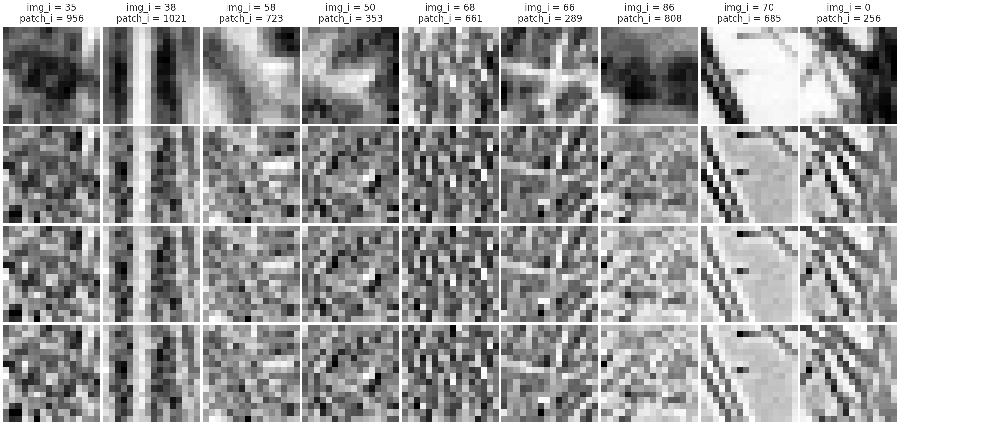

In [13]:
fig, axes = create_figure(4, ncols, (3.0 * ncols, 12.7), 'all', 'all', layout='constrained')
for i, (img_i, patch_i) in enumerate(ids.items()):
    axes[0, i].imshow(to_np(x[img_i, patch_i].squeeze()), cmap='Greys_r')
    axes[1, i].imshow(to_np(x_wt[img_i, patch_i].squeeze()), cmap='Greys_r')
    axes[2, i].imshow(to_np(x_wt_cn[img_i, patch_i].squeeze()), cmap='Greys_r')
    axes[3, i].imshow(to_np(x_wt_cn_zs[img_i, patch_i].squeeze()), cmap='Greys_r')
    axes[0, i].set_title(f"img_i = {img_i}\npatch_i = {patch_i}", y=1.03, fontsize=20)
remove_ticks(axes)
plt.show()

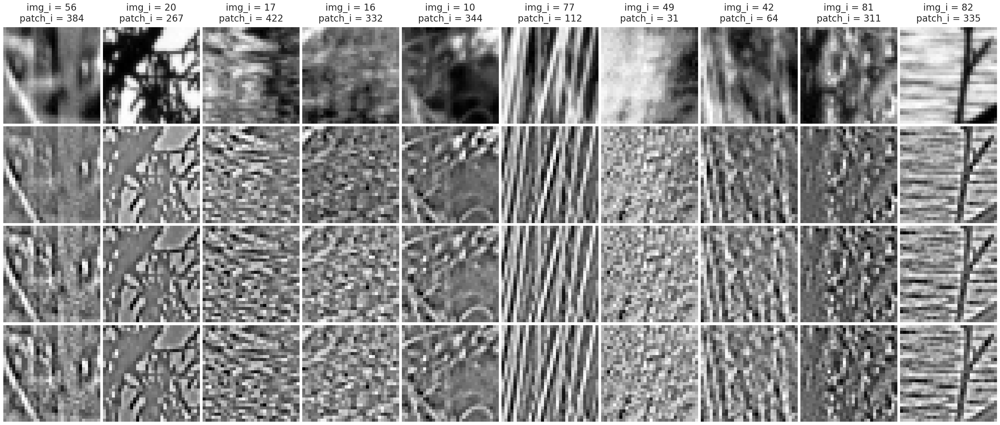

In [11]:
## Was 32 x 32

### Save

In [14]:
save_dir = pjoin(doves.path, 'xtract16')
os.makedirs(save_dir, exist_ok=True)
os.listdir(save_dir)

[]

In [15]:
save = {
    'patches': to_np(patches),
    'wt': to_np(x_wt),
    'wt_cn': to_np(x_wt_cn),
    'processed': to_np(x_wt_cn_zs),
}
for name, obj in save.items():
    save_obj(
        obj=obj,
        file_name=name,
        save_dir=save_dir,
        verbose=True,
        mode='npy',
    )

[PROGRESS] 'patches.npy' saved at
/home/hadi/Datasets/DOVES/xtract16

[PROGRESS] 'wt.npy' saved at
/home/hadi/Datasets/DOVES/xtract16

[PROGRESS] 'wt_cn.npy' saved at
/home/hadi/Datasets/DOVES/xtract16

[PROGRESS] 'processed.npy' saved at
/home/hadi/Datasets/DOVES/xtract16

In [16]:
to_np(patches).dtype, to_np(x_wt_cn_zs).dtype

(dtype('float32'), dtype('float32'))